# Code for part II of the assessment 
## based on practical week 6 by Andrew Renninger

## Let us get the data: road network, supermarkets and OAs

In [1]:
import networkx as nx
import osmnx as ox
import pandas as pd
import geopandas as gpd
import numpy as np
import statsmodels.api as sm
import matplotlib.pyplot as plt

let's start by getting the data, something you are already familiar with

In [2]:
# grab the street network for our area of interest
G = ox.graph.graph_from_place('Borough of Havering, London, UK', network_type='walk')

In [3]:
#n. of street intersections
len(G)

16351

In [4]:
# get the administrative boundary of the area
area = ox.geocode_to_gdf('Borough of Havering, London, UK')

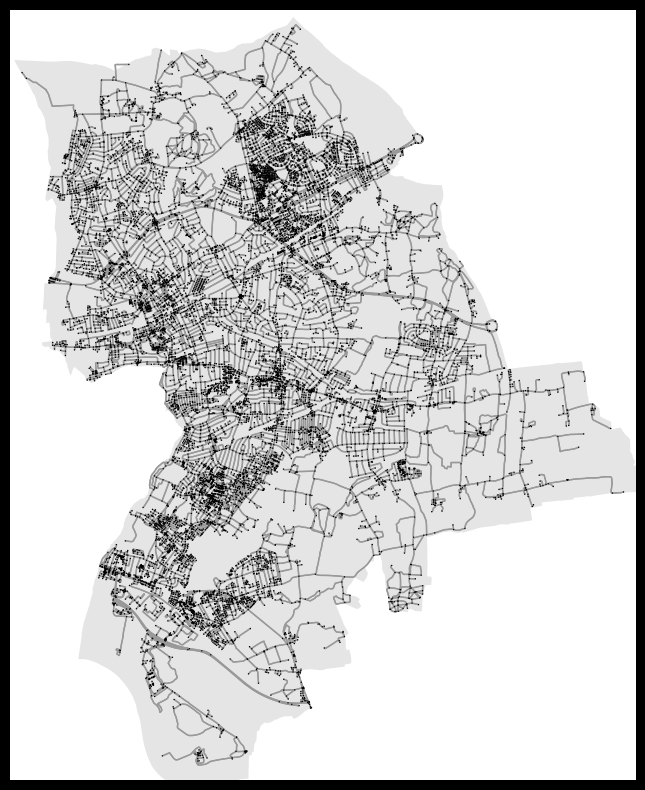

(<Figure size 1000x1000 with 1 Axes>, <Axes: >)

In [5]:
# plot the network on the area
fig, ax = plt.subplots(figsize=(10, 10),facecolor='k')
area.plot(ax=ax, facecolor='k', alpha=0.1)
ox.plot_graph(G, ax=ax, node_color='k', node_size=1)

for this and the assessment, we are going to use data on supermarkets from geolytix

In [6]:
retail = pd.read_csv("./geolytix_retailpoints_v34_202412.csv")
retail = gpd.GeoDataFrame(retail, geometry=gpd.points_from_xy(retail['long_wgs'], retail['lat_wgs']), crs="EPSG:4326")
retail = retail[retail['geometry'].within(area.loc[0, 'geometry'])]
retail.head()

,id,retailer,fascia,store_name,add_one,add_two,town,suburb,postcode,long_wgs,lat_wgs,bng_e,bng_n,pqi,open_date,size_band,county,geometry
8880,1010001769,Marks and Spencer,Marks and Spencer BP,M&S Hornchurch BP,Southend Arterial Road,NaN,London,Emerson Park,RM11 3UJ,0.240395,51.579830,555332.371570,189152.128284,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.2404 51.57983)
8881,1010000785,Asda,Asda Superstore,Asda Romford Superstore,Dolphin Approach,Mercury Gardens,London,Romford,RM1 3EE,0.185560,51.579473,551534.511561,188997.348277,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.18556 51.57947)
8882,1010008077,The Co-operative Group,The Co-operative Food,Co-op Harold Wood,15 Station Road,Harold Wood,London,Harold Wood,RM3 0BP,0.233400,51.593581,554801.026269,190666.388789,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.2334 51.59358)
8883,1010011531,Chelmsford Star Co-operative Society,The Co-operative Food,Co-op Mungo Park,150 Mungo Park Road,NaN,London,Elm Park,RM13 7PP,0.192236,51.540285,552127.681563,184653.568262,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.19224 51.54028)
8884,1010014460,The Southern Co-operative,The Co-operative Food,Co-op Hornchurch - Hornchurch Road,176-178 Hornchurch Road,NaN,London,Heath Park,RM11 1QL,0.200812,51.564993,552639.622492,187418.963916,Rooftop,20179999.0,"< 3,013 ft2 (280m2)",Greater London,POINT (0.20081 51.56499)


In [7]:
# how many grocery locations are there?
retail.shape

(56, 18)

In [8]:
# For the spatial interaction model, we need to area of the supermarkets as the attraction factor.
# let us extract it
import re
def extract_square_meter(x):
    # natch the square meter value, even if there is a range
    match = re.search(r'\((\d{1,3}(?:,\d{3})*)\s*(?:<\s*\d{1,3}(?:,\d{3})*)?\s*m2\)', x)
    if match:
        # extract the first value in the range, or the single value
        square_meter_str = match.group(1).replace(",", "")
        return int(square_meter_str)
    return None

retail['square_meters'] = retail['size_band'].apply(lambda x: extract_square_meter(x))
retail.head()


,id,retailer,fascia,store_name,add_one,add_two,town,suburb,postcode,long_wgs,lat_wgs,bng_e,bng_n,pqi,open_date,size_band,county,geometry,square_meters
8880,1010001769,Marks and Spencer,Marks and Spencer BP,M&S Hornchurch BP,Southend Arterial Road,NaN,London,Emerson Park,RM11 3UJ,0.240395,51.579830,555332.371570,189152.128284,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.2404 51.57983),280
8881,1010000785,Asda,Asda Superstore,Asda Romford Superstore,Dolphin Approach,Mercury Gardens,London,Romford,RM1 3EE,0.185560,51.579473,551534.511561,188997.348277,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.18556 51.57947),2800
8882,1010008077,The Co-operative Group,The Co-operative Food,Co-op Harold Wood,15 Station Road,Harold Wood,London,Harold Wood,RM3 0BP,0.233400,51.593581,554801.026269,190666.388789,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.2334 51.59358),280
8883,1010011531,Chelmsford Star Co-operative Society,The Co-operative Food,Co-op Mungo Park,150 Mungo Park Road,NaN,London,Elm Park,RM13 7PP,0.192236,51.540285,552127.681563,184653.568262,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.19224 51.54028),280
8884,1010014460,The Southern Co-operative,The Co-operative Food,Co-op Hornchurch - Hornchurch Road,176-178 Hornchurch Road,NaN,London,Heath Park,RM11 1QL,0.200812,51.564993,552639.622492,187418.963916,Rooftop,20179999.0,"< 3,013 ft2 (280m2)",Greater London,POINT (0.20081 51.56499),280


In [9]:
nodes, edges = ox.graph_to_gdfs(G)

Text(0.5, 1.0, 'Retail locations in Havering, London')

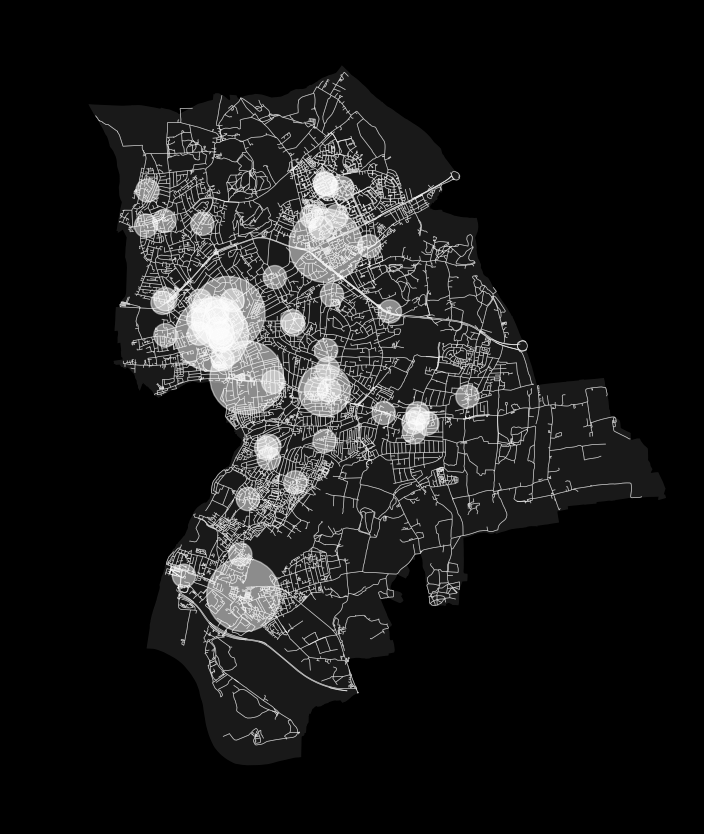

In [10]:
# let us plot the supermarkets according to their size 
fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')
area.plot(ax=ax, facecolor='w', alpha=0.1)
edges.plot(color='w', ax=ax, linewidth=0.5, alpha=0.5)
retail.plot(color='w', ax=ax, markersize='square_meters', alpha=0.5)
ax.set_facecolor('k')
ax.set_title('Retail locations in Havering, London')

In [11]:
# what are the biggest stores
retail = retail.sort_values('square_meters', ascending=False)
retail.head()

,id,retailer,fascia,store_name,add_one,add_two,town,suburb,postcode,long_wgs,lat_wgs,bng_e,bng_n,pqi,open_date,size_band,county,geometry,square_meters
8897,1010006288,Tesco,Tesco Extra,Tesco Rainham Extra,Bridge Road,Rainham,London,Rainham,RM13 9YZ,0.190737,51.520074,552091.001563,182402.998253,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.19074 51.52007),2800
8881,1010000785,Asda,Asda Superstore,Asda Romford Superstore,Dolphin Approach,Mercury Gardens,London,Romford,RM1 3EE,0.185560,51.579473,551534.511561,188997.348277,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.18556 51.57947),2800
8910,1010003189,Sainsburys,Sainsburys,Sainsburys Romford,1 The Brewery,NaN,London,Romford,RM1 1AU,0.179965,51.574915,551162.001560,188478.998274,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.17997 51.57492),2800
18264,1010006287,Tesco,Tesco Extra,Tesco Romford Extra,300 Hornchurch Road,Hornchurch,London,Heath Park,RM11 1PY,0.191840,51.565854,552015.001562,187495.998272,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.19184 51.56585),2800
8896,1010006290,Tesco,Tesco Extra,Tesco Romford Gallows Corner Extra,Bryant Avenue,Romford,London,Harold Wood,RM3 0LL,0.218663,51.593686,553780.001567,190646.998287,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.21866 51.59369),2800


In [12]:
# let us put the stores in the network. We get the nearest network node to each supermarket
retail['nodes'] = ox.nearest_nodes(G, retail['long_wgs'], retail['lat_wgs'])

In [13]:
# Each supermarket gets associated with a node (intersection point in the network)
retail['nodes'].to_numpy()

array([ 3126695258,    33472352,  2905549031,  4525271306,  1723271155,
        7097574945,    31073549, 11227619384,   245794863, 11909545221,
          31497656,    30865750,  5385551038,  5865912846,  7261100452,
        6322924734,  8628074642,  6332783669,    25894895,  2184904585,
        1567651769,  2142099759,    31387232,  8209435887,  8817642959,
        1127943270,   245015254, 10749201507, 12670836514,  3232129350,
          27340030,   747087848,  8205579182,  4472253157,  5380508003,
          31388110,  8091496508,    30991535,   245035059,  6769246246,
        4520240128,  6322924734,   747087748,  1266089657, 11132894624,
        3565590107,    45403833,    32567383,   245037871,  1612627338,
        2962708960,  2733299480, 11599007720,  3787358413,  6970755181,
        7265453259], dtype=int64)

we have now assigned each interaction to its nearest grocery store

In [14]:
#Now let us get the administrative units: OAs and take only the area defined
oa = gpd.read_file("./loac/loac_oa.gpkg")
oa = oa.to_crs(4326)
oa = oa[oa['geometry'].centroid.within(area.loc[0, 'geometry'])]
oa.head()

C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\3835493417.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa = oa[oa['geometry'].centroid.within(area.loc[0, 'geometry'])]


,OA21CD,G,SG,geometry
10547,E00011202,F2,F,"MULTIPOLYGON (((0.1515 51.56798, 0.15078 51.56..."
10548,E00011203,C2,C,"MULTIPOLYGON (((0.1761 51.56765, 0.17639 51.56..."
10549,E00011204,F1,F,"MULTIPOLYGON (((0.16157 51.57077, 0.16293 51.5..."
10550,E00011205,C2,C,"MULTIPOLYGON (((0.18129 51.56826, 0.18303 51.5..."
10551,E00011206,F1,F,"MULTIPOLYGON (((0.18693 51.56557, 0.18621 51.5..."


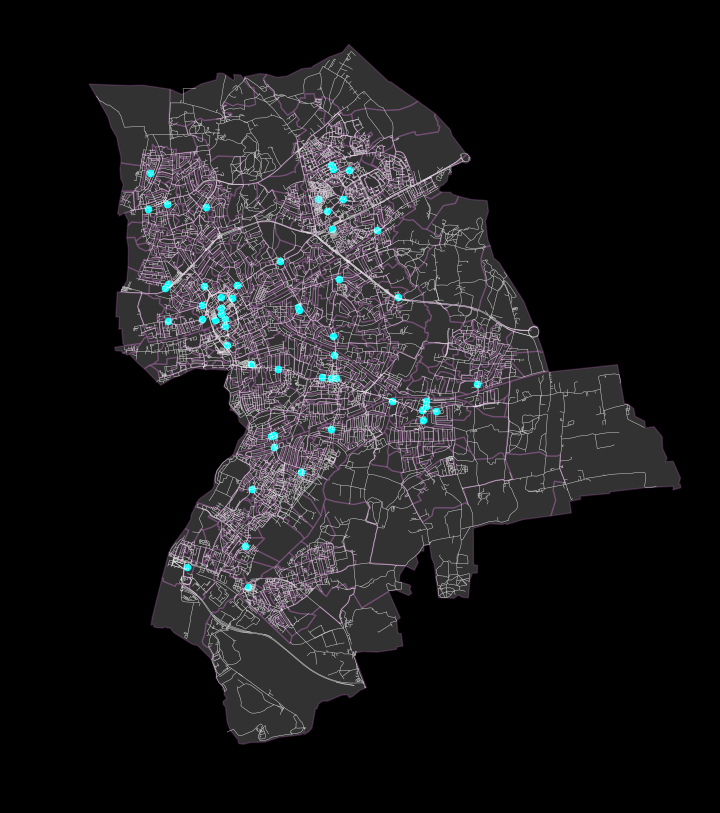

In [15]:
fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')
oa.plot(ax=ax, facecolor='w', alpha=0.2,edgecolor='violet', linewidth=1)
edges.plot(color='w', ax=ax, linewidth=0.3, alpha=0.5)
retail.plot(color='cyan', ax=ax, markersize=20)
ax.set_facecolor('k')

In [16]:
oa.shape

(775, 4)

In [17]:
# Load the precomputed distance matrix or interaction data
distance_matrix = pd.read_csv("oa_retail_distance_matrix.csv", index_col=0)

# Preview the first few rows
print(distance_matrix.head())

             1010006288   1010000785   1010003189   1010006287   1010006290  \
E00011202  11961.496696  3275.920817  2632.983056  3064.793628  6811.884116   
E00011203  10245.142980  2008.770715  1365.832954  1356.197792  5532.309332   
E00011204  11566.421195  2880.845316  2237.907556  2669.718128  6416.808615   
E00011205   9931.798972  1928.798235  1285.860475  1035.095905  5452.336853   
E00011206   9400.936952  1897.918481  1461.026492   511.991764  5141.244452   

            1010003188   1010001545   1010007336   1010014462   1010006056  \
E00011202  4950.937909  2914.283756  2547.495609  5006.431217  3575.925235   
E00011203  3242.342074  1647.133654  1267.920825  4135.589861  2308.775133   
E00011204  4555.862409  2519.208256  2152.420108  4611.355716  3180.849734   
E00011205  2921.240186  1567.161175  1187.948346  4055.617381  2228.802653   
E00011206  2398.136045  1545.886180  1154.037815  4230.783398  2220.768677   

           ...   1010005548   1010021837   1010006762   

In [18]:
pop_df = pd.read_csv("census2021_data/census2021-ts001-oa.csv")
pop_df.head()

,date,geography,geography code,Residence type: Total; measures: Value,Residence type: Lives in a household; measures: Value,Residence type: Lives in a communal establishment; measures: Value
0,2021,E00060274,E00060274,273,273,0
1,2021,E00060275,E00060275,416,416,0
2,2021,E00060276,E00060276,259,259,0
3,2021,E00060277,E00060277,278,278,0
4,2021,E00060279,E00060279,276,276,0


In [19]:
pop_df.columns

Index(['date', 'geography', 'geography code',
       'Residence type: Total; measures: Value',
       'Residence type: Lives in a household; measures: Value',
       'Residence type: Lives in a communal establishment; measures: Value'],
      dtype='object')

In [20]:
population = pop_df[['geography', 'Residence type: Total; measures: Value']].copy()

population.columns = ['OA21CD', 'population']
population['population'] = pd.to_numeric(population['population'], errors='coerce')

print(population.head())

      OA21CD  population
0  E00060274         273
1  E00060275         416
2  E00060276         259
3  E00060277         278
4  E00060279         276


In [21]:
retail.head()

,id,retailer,fascia,store_name,add_one,add_two,town,suburb,postcode,long_wgs,lat_wgs,bng_e,bng_n,pqi,open_date,size_band,county,geometry,square_meters,nodes
8897,1010006288,Tesco,Tesco Extra,Tesco Rainham Extra,Bridge Road,Rainham,London,Rainham,RM13 9YZ,0.190737,51.520074,552091.001563,182402.998253,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.19074 51.52007),2800,3126695258
8881,1010000785,Asda,Asda Superstore,Asda Romford Superstore,Dolphin Approach,Mercury Gardens,London,Romford,RM1 3EE,0.185560,51.579473,551534.511561,188997.348277,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.18556 51.57947),2800,33472352
8910,1010003189,Sainsburys,Sainsburys,Sainsburys Romford,1 The Brewery,NaN,London,Romford,RM1 1AU,0.179965,51.574915,551162.001560,188478.998274,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.17997 51.57492),2800,2905549031
18264,1010006287,Tesco,Tesco Extra,Tesco Romford Extra,300 Hornchurch Road,Hornchurch,London,Heath Park,RM11 1PY,0.191840,51.565854,552015.001562,187495.998272,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.19184 51.56585),2800,4525271306
8896,1010006290,Tesco,Tesco Extra,Tesco Romford Gallows Corner Extra,Bryant Avenue,Romford,London,Harold Wood,RM3 0LL,0.218663,51.593686,553780.001567,190646.998287,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.21866 51.59369),2800,1723271155


In [22]:
# Step 1: Prepare origin (OA) population data
population = population.set_index('OA21CD')

# Step 2: Prepare destination (retail) data
# Use 'id' as unique identifier and 'store_area' (or substitute) as attraction
retail = retail.copy()
retail['attraction'] = retail['square_meters'] 
retail = retail.set_index('id')

# Step 3: Reshape the distance matrix to long format
distance_long = distance_matrix.reset_index().melt(
    id_vars='index',
    var_name='id',
    value_name='distance'
)
distance_long.rename(columns={'index': 'OA21CD'}, inplace=True)

In [23]:
# Step 4: Merge population
distance_long = distance_long.merge(population, on='OA21CD', how='left')

distance_long['id'] = distance_long['id'].astype(str)
retail.index = retail.index.astype(str)

In [24]:
# Now merge again
distance_long = distance_long.merge(
    retail[['attraction','store_name','nodes']],
    left_on='id',
    right_index=True,
    how='left'
)

# Step 6: Clean and view
distance_long.dropna(subset=['population', 'attraction', 'distance'], inplace=True)
distance_long.head()

,OA21CD,id,distance,population,attraction,store_name,nodes
0,E00011202,1010006288,11961.496696,435,2800.0,Tesco Rainham Extra,3.126695e+09
1,E00011203,1010006288,10245.142980,326,2800.0,Tesco Rainham Extra,3.126695e+09
2,E00011204,1010006288,11566.421195,326,2800.0,Tesco Rainham Extra,3.126695e+09
3,E00011205,1010006288,9931.798972,376,2800.0,Tesco Rainham Extra,3.126695e+09
4,E00011206,1010006288,9400.936952,567,2800.0,Tesco Rainham Extra,3.126695e+09


In [25]:
# Define model parameters (from template calibration)
alpha = 1.7558
gamma = 1.6472
beta = 1.4079

In [26]:
# Step 1: Apply the multiplicative form of the gravity model
distance_long['T_gravity_raw'] = (
    (distance_long['population'] ** alpha) *
    (distance_long['attraction'] ** gamma) /
    (distance_long['distance'] ** beta)
)

# Step 2: Normalize the flows so their total equals total population (or any other target)
total_population = distance_long['population'].sum()
scaling_factor = total_population / distance_long['T_gravity_raw'].sum()

# Step 3: Apply the scaling factor to obtain final gravity flow estimates
distance_long['T_gravity'] = distance_long['T_gravity_raw'] * scaling_factor

In [27]:
distance_long

,OA21CD,id,distance,population,attraction,store_name,nodes,T_gravity_raw,T_gravity
0,E00011202,1010006288,11961.496696,435,2800.0,Tesco Rainham Extra,3.126695e+09,37128.200991,509.852825
1,E00011203,1010006288,10245.142980,326,2800.0,Tesco Rainham Extra,3.126695e+09,27826.452671,382.119121
2,E00011204,1010006288,11566.421195,326,2800.0,Tesco Rainham Extra,3.126695e+09,23457.854854,322.128551
3,E00011205,1010006288,9931.798972,376,2800.0,Tesco Rainham Extra,3.126695e+09,37347.188881,512.860016
4,E00011206,1010006288,9400.936952,567,2800.0,Tesco Rainham Extra,3.126695e+09,82998.873111,1139.759235
...,...,...,...,...,...,...,...,...,...
43395,E00176973,1010005537,3320.062609,544,280.0,Tesco Elm Park Romford Express,7.265453e+09,7528.378033,103.381384
43396,E00176974,1010005537,3483.595847,506,280.0,Tesco Elm Park Romford Express,7.265453e+09,6195.627482,85.079753
43397,E00176975,1010005537,4005.128084,197,280.0,Tesco Elm Park Romford Express,7.265453e+09,971.535929,13.341350
43398,E00176979,1010005537,5980.780219,413,280.0,Tesco Elm Park Romford Express,7.265453e+09,2026.499227,27.828344


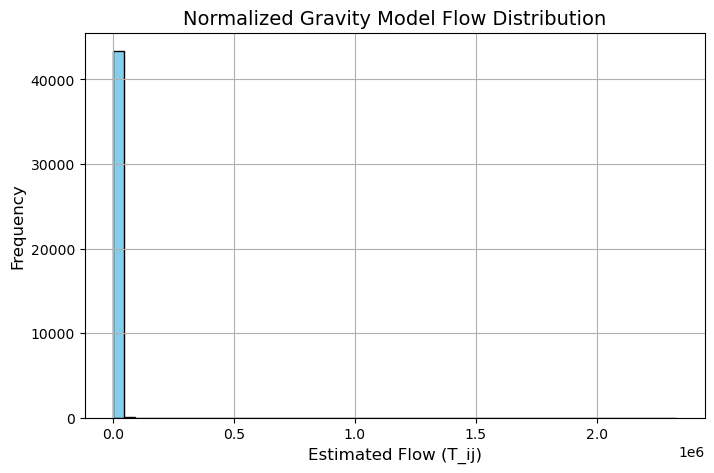

In [28]:
plt.figure(figsize=(8, 5))
plt.hist(distance_long['T_gravity'], bins=50, color='skyblue', edgecolor='black')
plt.title("Normalized Gravity Model Flow Distribution", fontsize=14)
plt.xlabel("Estimated Flow (T_ij)", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.grid(True)
plt.show()

In [29]:
# Sort the DataFrame by T_gravity in descending order
top_flows = distance_long.sort_values(by='T_gravity', ascending=False)

# Display the top 10 rows
top_flows.head(5)

,OA21CD,id,distance,population,attraction,store_name,nodes,T_gravity_raw,T_gravity
2287,E00176916,1010003189,32.775752,466,2800.0,Sainsburys Romford,2.905549e+09,1.696540e+08,2.329727e+06
2691,E00011577,1010006287,157.501181,384,2800.0,Tesco Romford Extra,4.525271e+09,1.324865e+07,1.819334e+05
2279,E00166786,1010003189,235.807131,310,2800.0,Sainsburys Romford,2.905549e+09,5.154288e+06,7.077984e+04
2329,E00011206,1010006287,511.991764,567,2800.0,Tesco Romford Extra,4.525271e+09,4.994920e+06,6.859136e+04
505,E00011717,1010006288,350.004101,415,2800.0,Tesco Rainham Extra,3.126695e+09,4.933180e+06,6.774354e+04


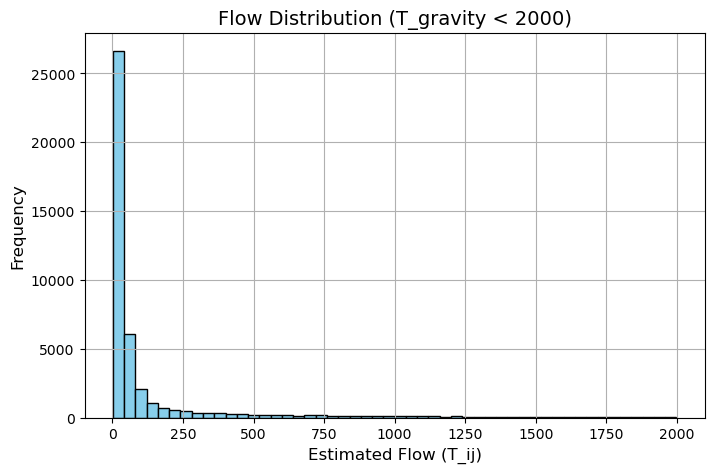

In [30]:
plt.figure(figsize=(8, 5))
filtered = distance_long[distance_long['T_gravity'] < 2000] 
plt.hist(filtered['T_gravity'], bins=50, color='skyblue', edgecolor='black')
plt.title("Flow Distribution (T_gravity < 2000)", fontsize=14)
plt.xlabel("Estimated Flow (T_ij)", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.grid(True)
plt.show()

In [31]:
# Count how many values are greater than 2000
count_above_2000 = (distance_long['T_gravity'] > 2000).sum()
print(f"Number of flows > 2000: {count_above_2000}")

Number of flows > 2000: 1207


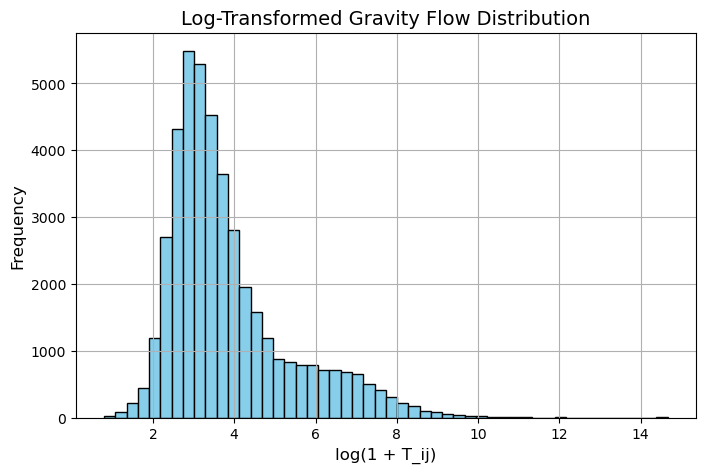

In [32]:
plt.figure(figsize=(8, 5))

# Apply log1p transformation to avoid log(0) issues
log_flows = np.log1p(distance_long['T_gravity'])

plt.hist(log_flows, bins=50, color='skyblue', edgecolor='black')
plt.title("Log-Transformed Gravity Flow Distribution", fontsize=14)
plt.xlabel("log(1 + T_ij)", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.grid(True)
plt.show()


                 Generalized Linear Model Regression Results                  
Dep. Variable:              T_gravity   No. Observations:                43400
Model:                            GLM   Df Residuals:                    43396
Model Family:                 Poisson   Df Model:                            3
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -1.2241e+05
Date:                Tue, 06 May 2025   Deviance:                  -9.9815e-11
Time:                        03:22:06   Pearson chi2:                 1.39e-19
No. Iterations:                     7   Pseudo R-squ. (CS):              1.000
Covariance Type:            nonrobust                                         
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
const             -4.2880      0.008   -528.

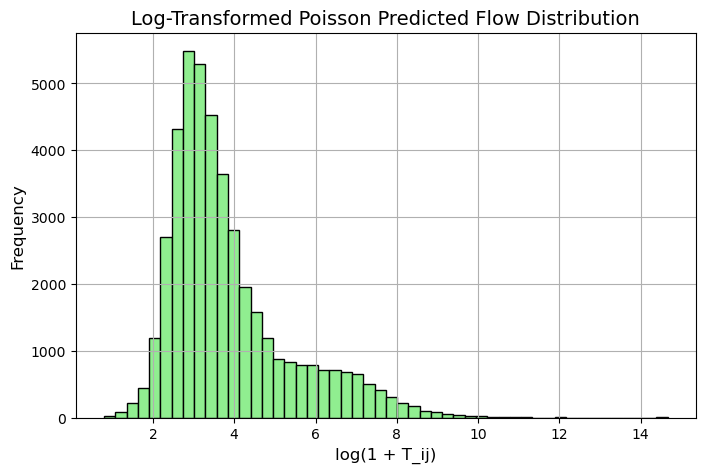

In [33]:
# Step 1: Prepare data (log-transform independent variables)
distance_long['log_population'] = np.log(distance_long['population'])
distance_long['log_attraction'] = np.log(distance_long['attraction'])
distance_long['log_distance'] = np.log(distance_long['distance'])

# Step 2: Create the design matrix (X) and the target (y)
X = distance_long[['log_population', 'log_attraction', 'log_distance']]
X = sm.add_constant(X)  # add intercept term
y = distance_long['T_gravity']  # use simulated flows as the target

# Step 3: Fit Poisson regression model
poisson_model = sm.GLM(y, X, family=sm.families.Poisson()).fit()

# Step 4: View model summary
print(poisson_model.summary())

# Step 5: Get predicted flows (lambda_ij)
distance_long['T_poisson_pred'] = poisson_model.predict(X)

# Optional: Log-transform the predictions for histogram
log_preds = np.log1p(distance_long['T_poisson_pred'])

# Step 6: Plot predicted flow distribution
plt.figure(figsize=(8, 5))
plt.hist(log_preds, bins=50, color='lightgreen', edgecolor='black')
plt.title("Log-Transformed Poisson Predicted Flow Distribution", fontsize=14)
plt.xlabel("log(1 + T_ij)", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.grid(True)
plt.show()

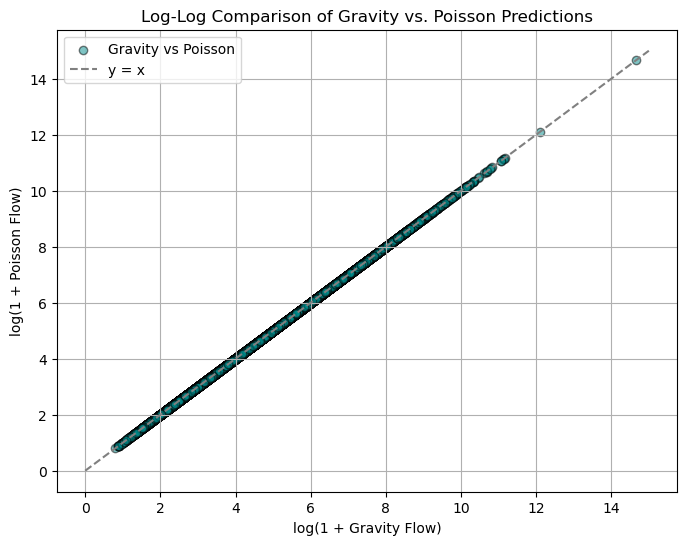

In [34]:
poisson_predictions = poisson_model.predict()

filtered = distance_long[distance_long['T_gravity'] < 2000]
filtered_predictions = poisson_predictions[filtered.index]

plt.figure(figsize=(8, 6))
plt.scatter(np.log1p(distance_long['T_gravity']), np.log1p(poisson_predictions),
            alpha=0.5, label='Gravity vs Poisson', color='darkcyan', edgecolor='black')
plt.xlabel("log(1 + Gravity Flow)")
plt.ylabel("log(1 + Poisson Flow)")
plt.title("Log-Log Comparison of Gravity vs. Poisson Predictions")
plt.plot([0, 15], [0, 15], linestyle='--', color='gray', label='y = x')  # 参考线
plt.grid(True)
plt.legend()
plt.show()

## A new supermarket will be constructed. You will be given 2 potential places
### Let those be: E00011326 and E00011710

In [35]:
# let us create an interactive map to select the OA for the new supermarkets
import folium
from folium import GeoJson, GeoJsonTooltip


# Initialize the map centered around your geometries
center = oa.geometry.unary_union.centroid
m = folium.Map(location=[center.y, center.x], zoom_start=13, tiles="cartodbpositron")

# Add OAs as GeoJson with tooltips showing the OA ID
# Replace 'oa_id_column' with the actual column name that holds the OA ID
GeoJson(
    oa,
    name="OAs",
    tooltip=GeoJsonTooltip(fields=["OA21CD"], aliases=["OA ID:"]),
    style_function=lambda x: {
        "fillColor": "lightgray",
        "color": "black",
        "weight": 1,
        "fillOpacity": 0.5,
    },
    highlight_function=lambda x: {"weight": 3, "color": "red"},
).add_to(m)

# Let us add the street network, edges layer (white lines)
GeoJson(
    edges,
    name="Edges",
    style_function=lambda x: {
        "color": "grey",
        "weight": 0.5,
        "opacity": 0.5
    }
).add_to(m)

# now let us add the retail centres
for _, row in retail.iterrows():
    #size = 10
    size = row['square_meters'] / 100  # adjust scale as needed

    folium.CircleMarker(
        location=[row['lat_wgs'], row['long_wgs']],
        radius=size,
        color='violet',
        fill=True,
        fill_opacity=0.5,
        weight=0.5,
        popup=f"{row['square_meters']} m²"
    ).add_to(m)

# Add layer control (to toggle layers on/off)
folium.LayerControl().add_to(m)
# Show the map
m

C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\834403442.py:7: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  center = oa.geometry.unary_union.centroid


In [36]:
# Let us see where they are
oa_ids = ['E00011326', 'E00011710']  # Replace with your actual OA IDs
selected_oas = oa[oa['OA21CD'].isin(oa_ids)]

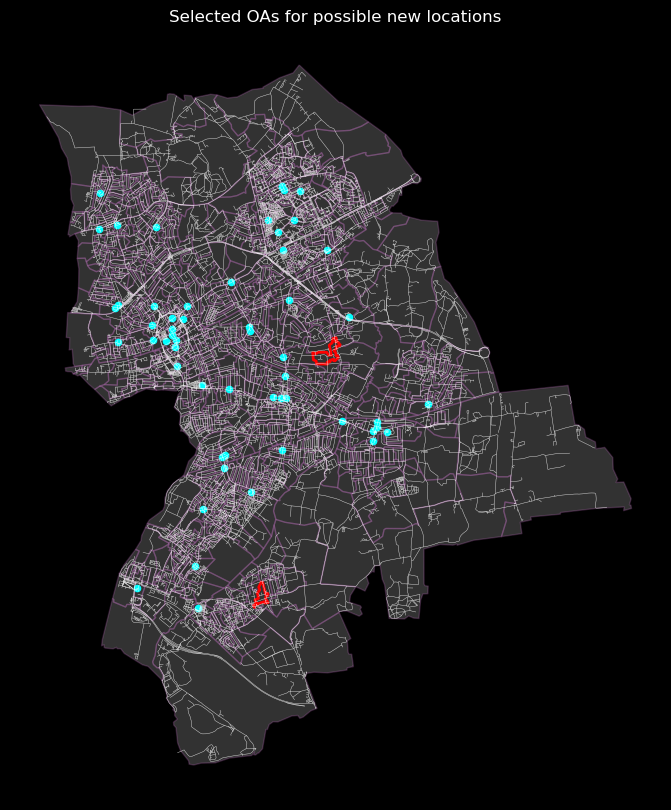

In [37]:
fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')

# Plot all OAs
oa.plot(ax=ax, facecolor='w', alpha=0.2, edgecolor='violet', linewidth=1)

# Plot roads: edges
edges.plot(ax=ax, color='w', linewidth=0.3, alpha=0.5)

# Plot retail locations
retail.plot(ax=ax, color='cyan', markersize=20)

# Plot selected OAs on top — highlighted in red
selected_oas.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=2)

# Set background
ax.set_facecolor('k')
ax.set_title("Selected OAs for possible new locations", color='white')

# Optional: turn off axis
ax.axis('off')

plt.show()

## Now need to get distances from OAs to supermarkets and 2 new possible supermarkets

In [38]:
# Let us take the centroid of each area and compute the distance
oa['lon'] = oa['geometry'].centroid.x
oa['lat'] = oa['geometry'].centroid.y

C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\314517002.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa['lon'] = oa['geometry'].centroid.x
C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\314517002.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa['lat'] = oa['geometry'].centroid.y


In [39]:
# let us join the centroids to its closest node
oa['nodes'] = ox.nearest_nodes(G, oa['lon'], oa['lat'])

In [40]:
oa

,OA21CD,G,SG,geometry,lon,lat,nodes
10547,E00011202,F2,F,"MULTIPOLYGON (((0.1515 51.56798, 0.15078 51.56...",0.152607,51.568958,691436925
10548,E00011203,C2,C,"MULTIPOLYGON (((0.1761 51.56765, 0.17639 51.56...",0.175162,51.566831,177734560
10549,E00011204,F1,F,"MULTIPOLYGON (((0.16157 51.57077, 0.16293 51.5...",0.157491,51.568243,5219365188
10550,E00011205,C2,C,"MULTIPOLYGON (((0.18129 51.56826, 0.18303 51.5...",0.179297,51.567164,1429395187
10551,E00011206,F1,F,"MULTIPOLYGON (((0.18693 51.56557, 0.18621 51.5...",0.183873,51.565608,31386337
...,...,...,...,...,...,...,...
23974,E00176973,E2,E,"MULTIPOLYGON (((0.18008 51.57209, 0.18039 51.5...",0.178808,51.572601,10282603620
23975,E00176974,D1,D,"MULTIPOLYGON (((0.18039 51.57172, 0.18032 51.5...",0.178890,51.571262,5151949179
23976,E00176975,F1,F,"MULTIPOLYGON (((0.1868 51.52204, 0.18703 51.52...",0.187803,51.522940,12003524846
23980,E00176979,B1,B,"MULTIPOLYGON (((0.22519 51.59008, 0.22461 51.5...",0.224739,51.590748,4692424677


In [41]:
selected_oas.columns

Index(['OA21CD', 'G', 'SG', 'geometry'], dtype='object')

In [42]:
selected_oas

,OA21CD,G,SG,geometry
10668,E00011326,G1,G,"MULTIPOLYGON (((0.23783 51.57398, 0.23628 51.5..."
11045,E00011710,G2,G,"MULTIPOLYGON (((0.2139 51.52265, 0.2131 51.522..."


In [43]:
# Compute centroids
selected_oas['lon'] = selected_oas['geometry'].centroid.x
selected_oas['lat'] = selected_oas['geometry'].centroid.y

# Add nearest network nodes
selected_oas['nodes'] = ox.nearest_nodes(G, selected_oas['lon'], selected_oas['lat'])

# now let us get the two extra locations
selected_nodes_ids=selected_oas['nodes'].values

C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\293902041.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  selected_oas['lon'] = selected_oas['geometry'].centroid.x
D:\anaconda3\envs\urbsim\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\293902041.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  selected_oas['lat'] = selected_oas['geo

In [44]:
selected_nodes_ids

array([ 31499457, 255145090], dtype=int64)

In [45]:
oa[oa['nodes'].isin(selected_nodes_ids)][['OA21CD', 'nodes']]

,OA21CD,nodes
10668,E00011326,31499457
11045,E00011710,255145090


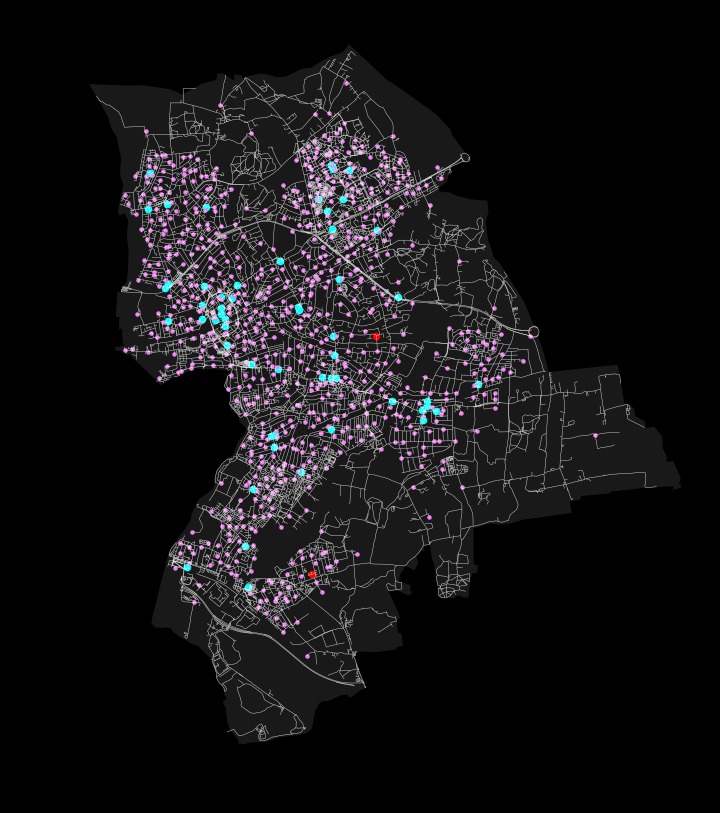

In [46]:
# let us plot the centroids in the map
oa_centroids = nodes.loc[oa['nodes'].unique()]
selected_nodes= nodes.loc[selected_nodes_ids]
fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')
oa.plot(ax=ax, facecolor='w', alpha=0.1)
edges.plot(color='w', ax=ax, linewidth=0.3, alpha=0.5)
retail.plot(color='cyan', ax=ax, markersize=20)
oa_centroids.plot(ax=ax, color='violet', markersize=5)
selected_nodes.plot(ax=ax, color='red', markersize=20)
ax.set_facecolor('k')
plt.show()

In [47]:
# Get origin and destination node lists

# Origin nodes from all OA centroids
origin_nodes = oa['nodes'].values


In [48]:
# Combine all destination nodes: retail + the 2 selected OAs
destination_nodes = list(retail['nodes'].values) + list(selected_nodes_ids)

In [49]:
# let us compute the distance matrix

# Create an empty distance matrix
distance_matrix = pd.DataFrame(index=origin_nodes, columns=destination_nodes)

# Compute shortest path lengths
for origin in origin_nodes:
    lengths = nx.single_source_dijkstra_path_length(G, origin, weight='length')
    for dest in destination_nodes:
        distance_matrix.loc[origin, dest] = lengths.get(dest, float('inf'))  # 'inf' if no path


In [50]:
distance_matrix

,3126695258,33472352,2905549031,4525271306,1723271155,7097574945,31073549,11227619384,245794863,11909545221,...,245037871,1612627338,2962708960,2733299480,11599007720,3787358413,6970755181,7265453259,31499457,255145090
691436925,11961.496696,3275.920817,2632.983056,3064.793628,6811.884116,4950.937909,2914.283756,2547.495609,5006.431217,3575.925235,...,2696.907899,2666.322691,7638.959722,7278.364217,7694.50773,7035.370623,8244.437735,4997.127201,6190.720499,11356.220701
177734560,10245.14298,2008.770715,1365.832954,1356.197792,5532.309332,3242.342074,1647.133654,1267.920825,4135.589861,2308.775133,...,1639.446306,1386.747908,5930.363886,5569.768381,6415.847282,6014.433858,7233.77789,3280.773485,4911.145716,9647.624865
5219365188,11566.421195,2880.845316,2237.907556,2669.718128,6416.808615,4555.862409,2519.208256,2152.420108,4611.355716,3180.849734,...,2301.832398,2271.247191,7243.884222,6883.288716,7299.432229,6640.295122,7849.362235,4602.0517,5795.644999,10961.145201
1429395187,9931.798972,1928.798235,1285.860475,1035.095905,5452.336853,2921.240186,1567.161175,1187.948346,4055.617381,2228.802653,...,1559.473827,1306.775428,5609.261998,5248.666493,6335.874802,5934.461379,7153.805411,2967.429477,4716.897218,9326.522978
31386337,9400.936952,1897.918481,1461.026492,511.991764,5141.244452,2398.136045,1545.88618,1154.037815,4230.783398,2220.768677,...,1734.639844,1259.295373,5086.157858,4725.562353,6120.090344,5718.67692,6938.020953,2436.567457,4221.631041,8803.418837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10282603620,10284.432104,1155.560338,512.622578,1366.801182,4981.806576,3252.945463,793.923278,697.044129,3282.379484,1455.564756,...,786.23593,604.662201,5940.967276,5580.371771,5640.866914,5239.45349,6458.797523,3320.062609,4373.688617,9658.228255
5151949179,10447.965343,1348.42577,705.48801,1530.334421,5163.691928,3416.478702,986.78871,889.909561,3475.244916,1648.430188,...,979.101362,797.527633,6104.500515,5743.90501,5833.732346,5432.318922,6651.662955,3483.595847,4542.528311,9821.761494
12003524846,4569.049517,7594.215477,7261.320659,5874.700414,9430.732382,5695.465208,7242.183176,6850.334811,9984.26088,7917.065673,...,7534.934011,6955.592369,7753.53071,7392.935204,10610.022767,10319.912052,11427.953375,4005.128084,7560.797303,6273.456068
4692424677,11620.039727,4782.531545,4827.425812,5283.647687,654.878541,3808.761285,4639.634545,4532.273276,4171.93071,4116.970314,...,5161.66401,4499.578371,6082.431463,5721.835958,1684.387208,1990.853384,2334.442422,5987.896691,3639.394712,10103.77321


In [51]:
oa_node_map = oa.set_index('nodes')['OA21CD'].to_dict()
retail_node_map = distance_long.drop_duplicates('id').set_index('nodes')['id'].to_dict()

# Rename index (origin nodes) from node IDs to OA21CD
distance_matrix.index = distance_matrix.index.map(oa_node_map)

# Rename columns (destination nodes) from node IDs to store names
distance_matrix.columns = distance_matrix.columns.map(retail_node_map)

distance_matrix.columns = list(distance_matrix.columns[:-2]) + ['node_id_1', 'node_id_2']

In [52]:
distance_matrix

,1010006288,1010000785,1010003189,1010006287,1010006290,1010003188,1010001545,1010007336,1010014462,1010006056,...,1010005548,1010021837,1010006762,1010000405,1010022862,1010020576,1010015073,1010005537,node_id_1,node_id_2
E00011202,11961.496696,3275.920817,2632.983056,3064.793628,6811.884116,4950.937909,2914.283756,2547.495609,5006.431217,3575.925235,...,2696.907899,2666.322691,7638.959722,7278.364217,7694.50773,7035.370623,8244.437735,4997.127201,6190.720499,11356.220701
E00011203,10245.14298,2008.770715,1365.832954,1356.197792,5532.309332,3242.342074,1647.133654,1267.920825,4135.589861,2308.775133,...,1639.446306,1386.747908,5930.363886,5569.768381,6415.847282,6014.433858,7233.77789,3280.773485,4911.145716,9647.624865
E00011204,11566.421195,2880.845316,2237.907556,2669.718128,6416.808615,4555.862409,2519.208256,2152.420108,4611.355716,3180.849734,...,2301.832398,2271.247191,7243.884222,6883.288716,7299.432229,6640.295122,7849.362235,4602.0517,5795.644999,10961.145201
E00011205,9931.798972,1928.798235,1285.860475,1035.095905,5452.336853,2921.240186,1567.161175,1187.948346,4055.617381,2228.802653,...,1559.473827,1306.775428,5609.261998,5248.666493,6335.874802,5934.461379,7153.805411,2967.429477,4716.897218,9326.522978
E00011206,9400.936952,1897.918481,1461.026492,511.991764,5141.244452,2398.136045,1545.88618,1154.037815,4230.783398,2220.768677,...,1734.639844,1259.295373,5086.157858,4725.562353,6120.090344,5718.67692,6938.020953,2436.567457,4221.631041,8803.418837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
E00176973,10284.432104,1155.560338,512.622578,1366.801182,4981.806576,3252.945463,793.923278,697.044129,3282.379484,1455.564756,...,786.23593,604.662201,5940.967276,5580.371771,5640.866914,5239.45349,6458.797523,3320.062609,4373.688617,9658.228255
E00176974,10447.965343,1348.42577,705.48801,1530.334421,5163.691928,3416.478702,986.78871,889.909561,3475.244916,1648.430188,...,979.101362,797.527633,6104.500515,5743.90501,5833.732346,5432.318922,6651.662955,3483.595847,4542.528311,9821.761494
E00176975,4569.049517,7594.215477,7261.320659,5874.700414,9430.732382,5695.465208,7242.183176,6850.334811,9984.26088,7917.065673,...,7534.934011,6955.592369,7753.53071,7392.935204,10610.022767,10319.912052,11427.953375,4005.128084,7560.797303,6273.456068
E00176979,11620.039727,4782.531545,4827.425812,5283.647687,654.878541,3808.761285,4639.634545,4532.273276,4171.93071,4116.970314,...,5161.66401,4499.578371,6082.431463,5721.835958,1684.387208,1990.853384,2334.442422,5987.896691,3639.394712,10103.77321


In [53]:
#distance_matrix.to_csv("oa_to_retail_and_selected_nodes_distance_matrix.csv")

In [54]:
# Get all existing store columns, excluding the new ones
existing_store_ids = [col for col in distance_matrix.columns if col not in ['node_id_1', 'node_id_2']]

# Compute mean attraction size (assumed size for new candidates)
mean_attraction = retail['attraction'].mean()

# Create two versions of the distance matrix with each new candidate
distance_matrix_1 = distance_matrix[existing_store_ids + ['node_id_1']].copy()
distance_matrix_2 = distance_matrix[existing_store_ids + ['node_id_2']].copy()

In [55]:
# 1. Reshape to long format
distance_long_1 = distance_matrix_1.reset_index().melt(
    id_vars='index',
    var_name='id',
    value_name='distance'
)
distance_long_1.rename(columns={'index': 'OA21CD'}, inplace=True)

# 2. Merge with OA population
distance_long_1 = distance_long_1.merge(population, on='OA21CD', how='left')

# Ensure ID columns are same dtype
distance_long_1['id'] = distance_long_1['id'].astype(str)
retail.index = retail.index.astype(str)

# 3. Merge with retail store info (attraction, etc.)
distance_long_1 = distance_long_1.merge(
    retail[['attraction']],
    left_on='id',
    right_index=True,
    how='left'
)

# Now fill in attraction for the new candidate location AFTER merge
distance_long_1.loc[distance_long_1['id'] == 'node_id_1', 'attraction'] = mean_attraction

# 4. Drop missing values
distance_long_1.dropna(subset=['population', 'attraction', 'distance'], inplace=True)

In [56]:
def prepare_distance_long(distance_matrix, node_id, population, retail, mean_attraction):
    # Step 1: Reshape distance matrix to long format
    distance_long = distance_matrix.reset_index().melt(
        id_vars='index',
        var_name='id',
        value_name='distance'
    )
    distance_long.rename(columns={'index': 'OA21CD'}, inplace=True)

    # Step 2: Merge with OA population
    distance_long = distance_long.merge(population, on='OA21CD', how='left')

    # Step 3: Ensure ID types match
    distance_long['id'] = distance_long['id'].astype(str)
    retail.index = retail.index.astype(str)

    # Step 4: Merge with retail info
    distance_long = distance_long.merge(
        retail[['attraction']],
        left_on='id',
        right_index=True,
        how='left'
    )

    # Step 5: Fill mean attraction for new candidate node
    distance_long.loc[distance_long['id'] == node_id, 'attraction'] = mean_attraction

    # Step 6: Drop missing values
    distance_long.dropna(subset=['population', 'attraction', 'distance'], inplace=True)

    return distance_long


In [57]:
# Make sure node IDs are strings if necessary
node_id_1 = 'node_id_1'
node_id_2 = 'node_id_2'

distance_long_1 = prepare_distance_long(distance_matrix_1, node_id_1, population, retail, mean_attraction)
distance_long_2 = prepare_distance_long(distance_matrix_2, node_id_2, population, retail, mean_attraction)


In [58]:
distance_long_1

,OA21CD,id,distance,population,attraction
0,E00011202,1010006288,11961.496696,435,2800.0
1,E00011203,1010006288,10245.14298,326,2800.0
2,E00011204,1010006288,11566.421195,326,2800.0
3,E00011205,1010006288,9931.798972,376,2800.0
4,E00011206,1010006288,9400.936952,567,2800.0
...,...,...,...,...,...
45720,E00176973,node_id_1,4373.688617,544,545.0
45721,E00176974,node_id_1,4542.528311,506,545.0
45722,E00176975,node_id_1,7560.797303,197,545.0
45723,E00176979,node_id_1,3639.394712,413,545.0


In [59]:
distance_long_2[distance_long_2['id'] == 'node_id_2']

,OA21CD,id,distance,population,attraction
44950,E00011202,node_id_2,11356.220701,435,545.0
44951,E00011203,node_id_2,9647.624865,326,545.0
44952,E00011204,node_id_2,10961.145201,326,545.0
44953,E00011205,node_id_2,9326.522978,376,545.0
44954,E00011206,node_id_2,8803.418837,567,545.0
...,...,...,...,...,...
45720,E00176973,node_id_2,9658.228255,544,545.0
45721,E00176974,node_id_2,9821.761494,506,545.0
45722,E00176975,node_id_2,6273.456068,197,545.0
45723,E00176979,node_id_2,10103.77321,413,545.0


In [60]:
def compute_gravity_flow(df, alpha, gamma, beta, normalize=False):
    df = df.copy()
    df['distance'] = df['distance'].replace(0, 1e-6)
    df['T_gravity_raw'] = (
        (df['population'] ** alpha) *
        (df['attraction'] ** gamma) /
        (df['distance'] ** beta)
    )
    if normalize:
        scaling_factor = df['population'].sum() / df['T_gravity_raw'].sum()
        df['T_gravity'] = df['T_gravity_raw'] * scaling_factor
    else:
        df['T_gravity'] = df['T_gravity_raw']
    return df


In [61]:
distance_long_1 = compute_gravity_flow(distance_long_1, alpha, gamma, beta, normalize=True)
distance_long_2 = compute_gravity_flow(distance_long_2, alpha, gamma, beta, normalize=True)

C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\519416229.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['distance'] = df['distance'].replace(0, 1e-6)
C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\519416229.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['distance'] = df['distance'].replace(0, 1e-6)


In [62]:
distance_long_1

,OA21CD,id,distance,population,attraction,T_gravity_raw,T_gravity
0,E00011202,1010006288,11961.496696,435,2800.0,37128.200991,1.934877e-06
1,E00011203,1010006288,10245.142980,326,2800.0,27826.452671,1.450131e-06
2,E00011204,1010006288,11566.421195,326,2800.0,23457.854854,1.222469e-06
3,E00011205,1010006288,9931.798972,376,2800.0,37347.188881,1.946289e-06
4,E00011206,1010006288,9400.936952,567,2800.0,82998.873111,4.325354e-06
...,...,...,...,...,...,...,...
45720,E00176973,node_id_1,4373.688617,544,545.0,15297.031606,7.971805e-07
45721,E00176974,node_id_1,4542.528311,506,545.0,12771.162911,6.655488e-07
45722,E00176975,node_id_1,7560.797303,197,545.0,1189.544795,6.199124e-08
45723,E00176979,node_id_1,3639.394712,413,545.0,12215.309221,6.365814e-07


In [63]:
distance_long_2

,OA21CD,id,distance,population,attraction,T_gravity_raw,T_gravity
0,E00011202,1010006288,11961.496696,435,2800.0,37128.200991,2.109917e-06
1,E00011203,1010006288,10245.142980,326,2800.0,27826.452671,1.581319e-06
2,E00011204,1010006288,11566.421195,326,2800.0,23457.854854,1.333060e-06
3,E00011205,1010006288,9931.798972,376,2800.0,37347.188881,2.122362e-06
4,E00011206,1010006288,9400.936952,567,2800.0,82998.873111,4.716651e-06
...,...,...,...,...,...,...,...
45720,E00176973,node_id_2,9658.228255,544,545.0,5014.408670,2.849583e-07
45721,E00176974,node_id_2,9821.761494,506,545.0,4312.572037,2.450744e-07
45722,E00176975,node_id_2,6273.456068,197,545.0,1547.056621,8.791597e-08
45723,E00176979,node_id_2,10103.773210,413,545.0,2901.115194,1.648643e-07


In [64]:
node_id_1, node_id_2 = selected_nodes_ids  # unpack the two node IDs
store_coords = {
    'node_id_1': nodes.loc[node_id_1, 'geometry'].centroid,
    'node_id_2': nodes.loc[node_id_2, 'geometry'].centroid
}

In [65]:
# Get the OA code of node_id_1
oa_node_1 = oa.loc[oa['nodes'] == selected_nodes_ids[0], 'OA21CD'].values[0]

# Filter flows to node_id_1, excluding flows where origin OA == destination OA
flows_1 = distance_long_1[
    (distance_long_1['id'] == 'node_id_1') & 
    (distance_long_1['OA21CD'] != oa_node_1)
].copy()

In [66]:
# Get OA centroid coordinates
oa_coords = oa.set_index('OA21CD')['geometry'].centroid

C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\3633169100.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa_coords = oa.set_index('OA21CD')['geometry'].centroid


In [67]:
# Get geometry for node_id_1 (assumes nodes is a GeoDataFrame with node IDs as index)
store_coord = nodes.loc[selected_nodes_ids[0], 'geometry'].centroid

In [68]:
# Get the OA code of node_id_2
oa_node_2 = oa.loc[oa['nodes'] == selected_nodes_ids[1], 'OA21CD'].values[0]

# Filter flows to node_id_2, excluding flows where origin OA == destination OA
flows_2 = distance_long_2[
    (distance_long_2['id'] == 'node_id_2') &
    (distance_long_2['OA21CD'] != oa_node_2)
].copy()


In [69]:
# Reuse previously defined OA centroid coordinates
oa_coords = oa.set_index('OA21CD')['geometry'].centroid

# Get geometry of node_id_2
store_coord_2 = nodes.loc[selected_nodes_ids[1], 'geometry'].centroid

C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\3925653468.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa_coords = oa.set_index('OA21CD')['geometry'].centroid


C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\3697453122.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa_coords = oa.set_index('OA21CD')['geometry'].centroid


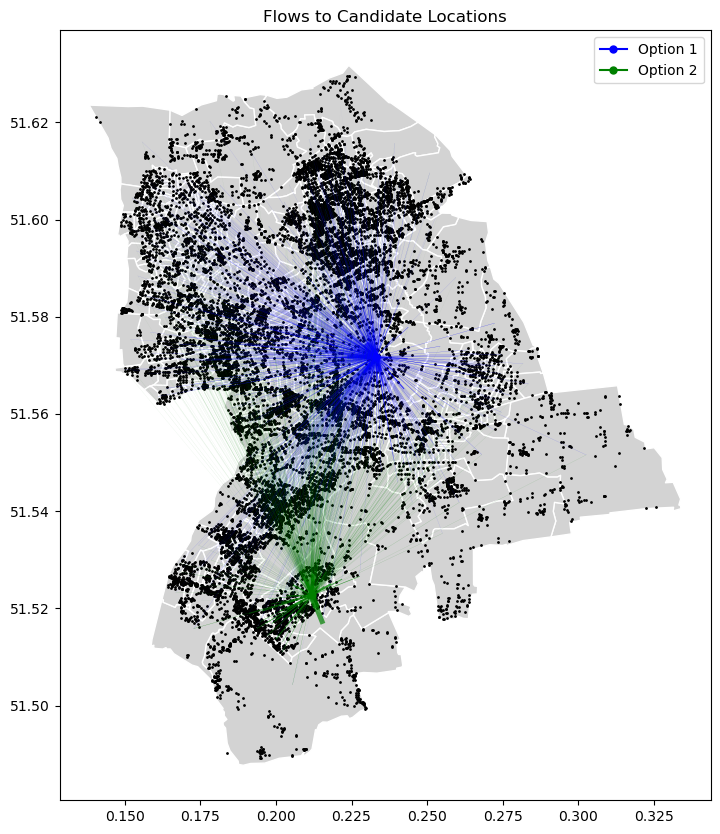

In [70]:
# Prepare OA centroid coordinates
oa_coords = oa.set_index('OA21CD')['geometry'].centroid

# Get the OA codes of the candidate nodes
oa_node_1 = oa.loc[oa['nodes'] == selected_nodes_ids[0], 'OA21CD'].values[0]
oa_node_2 = oa.loc[oa['nodes'] == selected_nodes_ids[1], 'OA21CD'].values[0]

# Filter flows to node_id_1 and node_id_2, excluding intra-OA flows
flows_1 = distance_long_1[
    (distance_long_1['id'] == 'node_id_1') &
    (distance_long_1['OA21CD'] != oa_node_1)
].copy()

flows_2 = distance_long_2[
    (distance_long_2['id'] == 'node_id_2') &
    (distance_long_2['OA21CD'] != oa_node_2)
].copy()

# Get the centroid geometry of each candidate node
store_coord_1 = nodes.loc[selected_nodes_ids[0], 'geometry'].centroid
store_coord_2 = nodes.loc[selected_nodes_ids[1], 'geometry'].centroid

# Start plotting
fig, ax = plt.subplots(figsize=(10, 10))
oa.plot(ax=ax, facecolor='lightgrey', edgecolor='white')
nodes.plot(ax=ax, color='black', markersize=1)

# Plot flows to node_id_1 in blue
for _, row in flows_1.iterrows():
    origin = oa_coords[row['OA21CD']]
    ax.plot(
        [origin.x, store_coord_1.x],
        [origin.y, store_coord_1.y],
        color='blue',
        linewidth=row['T_gravity'] / flows_1['T_gravity'].max() * 5,
        alpha=0.7
    )

# Plot flows to node_id_2 in green
for _, row in flows_2.iterrows():
    origin = oa_coords[row['OA21CD']]
    ax.plot(
        [origin.x, store_coord_2.x],
        [origin.y, store_coord_2.y],
        color='green',
        linewidth=row['T_gravity'] / flows_2['T_gravity'].max() * 5,
        alpha=0.7
    )

# Highlight candidate store locations
ax.plot(store_coord_1.x, store_coord_1.y, marker='o', color='blue', markersize=5, label='Option 1')
ax.plot(store_coord_2.x, store_coord_2.y, marker='o', color='green', markersize=5, label='Option 2')

plt.legend()
plt.title("Flows to Candidate Locations")
plt.show()

In [71]:
total_flow_to_node_1 = flows_1['T_gravity'].sum()
print(total_flow_to_node_1)
total_flow_to_node_2 = flows_2['T_gravity'].sum()
print(total_flow_to_node_2)
print((total_flow_to_node_1 - total_flow_to_node_2) / total_flow_to_node_2)

0.0003834071958901895
0.00023700810091604395
0.6176965867761832


In [72]:
# Simulate increased transport cost by raising beta (deterrence factor)
beta_high = 5.0 

# Make deep copies first to ensure independent calculation
distance_long_1_high = distance_long_1.copy().drop(columns=['T_gravity', 'T_gravity_raw'], errors='ignore')
distance_long_2_high = distance_long_2.copy().drop(columns=['T_gravity', 'T_gravity_raw'], errors='ignore')

In [73]:
#flows_1_high = compute_gravity_flow(distance_long_1_high, alpha, gamma, beta_high, normalize=False)
#flows_2_high = compute_gravity_flow(distance_long_2_high, alpha, gamma, beta_high, normalize=False)

flows_1_high = compute_gravity_flow(distance_long_1_high, alpha, gamma, beta_high, normalize=True)
flows_2_high = compute_gravity_flow(distance_long_2_high, alpha, gamma, beta_high, normalize=True)

In [74]:
flows_1_high  = flows_1_high[
    (flows_1_high['id'] == 'node_id_1') & 
    (flows_1_high['OA21CD'] != oa_node_1)
].copy()

In [75]:
flows_1_high

,OA21CD,id,distance,population,attraction,T_gravity_raw,T_gravity
44950,E00011202,node_id_1,6190.720499,435,545.0,1.518259e-10,2.216640e-42
44951,E00011203,node_id_1,4911.145716,326,545.0,2.911962e-10,4.251431e-42
44952,E00011204,node_id_1,5795.644999,326,545.0,1.272304e-10,1.857549e-42
44953,E00011205,node_id_1,4716.897218,376,545.0,4.577465e-10,6.683048e-42
44954,E00011206,node_id_1,4221.631041,567,545.0,1.639578e-09,2.393765e-41
...,...,...,...,...,...,...,...
45720,E00176973,node_id_1,4373.688617,544,545.0,1.277373e-09,1.864949e-41
45721,E00176974,node_id_1,4542.528311,506,545.0,9.307897e-10,1.358942e-41
45722,E00176975,node_id_1,7560.797303,197,545.0,1.390523e-11,2.030148e-43
45723,E00176979,node_id_1,3639.394712,413,545.0,1.973929e-09,2.881915e-41


In [81]:
flows_1

,OA21CD,id,distance,population,attraction,T_gravity_raw,T_gravity
44950,E00011202,node_id_1,6190.720499,435,545.0,6333.726778,3.300721e-07
44951,E00011203,node_id_1,4911.145716,326,545.0,5287.903104,2.755707e-07
44952,E00011204,node_id_1,5795.644999,326,545.0,4188.213292,2.182621e-07
44953,E00011205,node_id_1,4716.897218,376,545.0,7190.618914,3.747277e-07
44954,E00011206,node_id_1,4221.631041,567,545.0,17290.986629,9.010923e-07
...,...,...,...,...,...,...,...
45720,E00176973,node_id_1,4373.688617,544,545.0,15297.031606,7.971805e-07
45721,E00176974,node_id_1,4542.528311,506,545.0,12771.162911,6.655488e-07
45722,E00176975,node_id_1,7560.797303,197,545.0,1189.544795,6.199124e-08
45723,E00176979,node_id_1,3639.394712,413,545.0,12215.309221,6.365814e-07


In [76]:
total_flow_to_node_1  = flows_1['T_gravity'].sum()
print(total_flow_to_node_1)

total_flow_1_high  = flows_1_high['T_gravity'].sum()
print(total_flow_1_high)

0.0003834071958901895
5.829529304152032e-36


In [77]:
flows_2_high  = flows_2_high[
    (flows_2_high['id'] == 'node_id_2') & 
    (flows_2_high['OA21CD'] != oa_node_2)
].copy()

In [78]:
total_flow_to_node_2  = flows_2['T_gravity'].sum()
print(total_flow_to_node_2)

total_flow_2_high  = flows_2_high['T_gravity'].sum()
print(total_flow_2_high)

0.00023700810091604395
6.15749952779115e-36


In [79]:
print((total_flow_to_node_1 - total_flow_to_node_2) / total_flow_to_node_2)
print((total_flow_1_high - total_flow_2_high) / total_flow_2_high)

0.6176965867761832
-0.05326354020148326


C:\Users\sixan\AppData\Local\Temp\ipykernel_76540\1841834929.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa_coords = oa.set_index('OA21CD')['geometry'].centroid


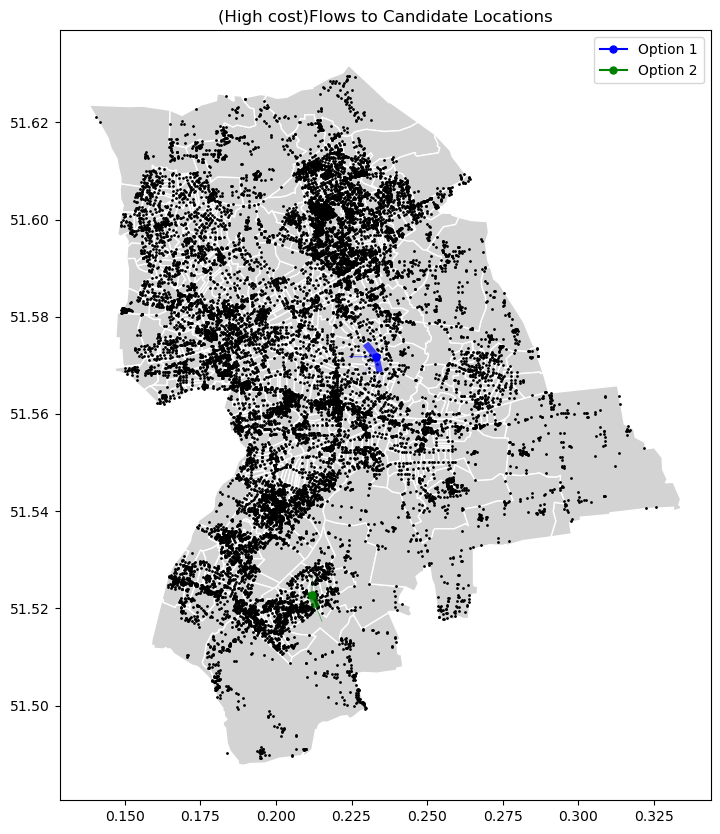

In [80]:
# Prepare OA centroid coordinates
oa_coords = oa.set_index('OA21CD')['geometry'].centroid

# Get the OA codes of the candidate nodes
oa_node_1 = oa.loc[oa['nodes'] == selected_nodes_ids[0], 'OA21CD'].values[0]
oa_node_2 = oa.loc[oa['nodes'] == selected_nodes_ids[1], 'OA21CD'].values[0]

# Filter flows to node_id_1 and node_id_2, excluding intra-OA flows
flows_1_high = flows_1_high[
    (flows_1_high['id'] == 'node_id_1') &
    (flows_1_high['OA21CD'] != oa_node_1)
].copy()

flows_2_high = flows_2_high[
    (flows_2_high['id'] == 'node_id_2') &
    (flows_2_high['OA21CD'] != oa_node_2)
].copy()

# Get the centroid geometry of each candidate node
store_coord_1 = nodes.loc[selected_nodes_ids[0], 'geometry'].centroid
store_coord_2 = nodes.loc[selected_nodes_ids[1], 'geometry'].centroid

# Start plotting
fig, ax = plt.subplots(figsize=(10, 10))
oa.plot(ax=ax, facecolor='lightgrey', edgecolor='white')
nodes.plot(ax=ax, color='black', markersize=1)

# Plot flows to node_id_1 in blue
for _, row in flows_1_high.iterrows():
    origin = oa_coords[row['OA21CD']]
    ax.plot(
        [origin.x, store_coord_1.x],
        [origin.y, store_coord_1.y],
        color='blue',
        linewidth=row['T_gravity'] / flows_1_high['T_gravity'].max() * 5,
        alpha=0.7
    )

# Plot flows to node_id_2 in green
for _, row in flows_2_high.iterrows():
    origin = oa_coords[row['OA21CD']]
    ax.plot(
        [origin.x, store_coord_2.x],
        [origin.y, store_coord_2.y],
        color='green',
        linewidth=row['T_gravity'] / flows_2_high['T_gravity'].max() * 5,
        alpha=0.7
    )

# Highlight candidate store locations
ax.plot(store_coord_1.x, store_coord_1.y, marker='o', color='blue', markersize=5, label='Option 1')
ax.plot(store_coord_2.x, store_coord_2.y, marker='o', color='green', markersize=5, label='Option 2')

plt.legend()
plt.title("(High cost)Flows to Candidate Locations")
plt.show()

In [82]:
# Correct walking speed: 1.33 meters/second
walk_speed_m_per_min = 1.33 * 60       
max_walk_distance = walk_speed_m_per_min * 

In [83]:

walkable_flows_1 = distance_long_1[
    (distance_long_1['id'] == 'node_id_1') &
    (distance_long_1['distance'] <= max_walk_distance)
]

walkable_population_1 = walkable_flows_1['population'].sum()
print(f"People within 15min walk to Option 1: {walkable_population_1}")


People within 15min walk to Option 1: 4517


In [84]:
walkable_flows_2 = distance_long_2[
    (distance_long_2['id'] == 'node_id_2') &
    (distance_long_2['distance'] <= max_walk_distance)
]

walkable_population_2 = walkable_flows_2['population'].sum()
print(f"People within 15min walk to Option 2: {walkable_population_2}")


People within 15min walk to Option 2: 6589


In [88]:
walkable_flows_1

,OA21CD,id,distance,population,attraction,T_gravity_raw,T_gravity
45003,E00011257,node_id_1,976.010515,331,545.0,5.282668e+04,2.752978e-06
45071,E00011326,node_id_1,0.000001,374,545.0,2.966472e+17,1.545930e+07
45077,E00011332,node_id_1,1110.384465,239,545.0,2.486918e+04,1.296018e-06
45078,E00011333,node_id_1,592.808714,463,545.0,1.921467e+05,1.001342e-05
45080,E00011335,node_id_1,898.802035,299,545.0,4.962633e+04,2.586197e-06
45081,E00011336,node_id_1,984.985436,348,545.0,5.694392e+04,2.967542e-06
45082,E00011337,node_id_1,357.746428,361,545.0,2.527463e+05,1.317147e-05
45083,E00011338,node_id_1,1025.332954,327,545.0,4.824347e+04,2.514132e-06
45084,E00011339,node_id_1,683.885924,346,545.0,9.421686e+04,4.909962e-06
45085,E00011340,node_id_1,756.637586,315,545.0,6.930103e+04,3.611513e-06


In [89]:
walkable_flows_2

,OA21CD,id,distance,population,attraction,T_gravity_raw,T_gravity
45434,E00011696,node_id_2,965.098211,294,545.0,4.358513e+04,2.476851e-06
45435,E00011697,node_id_2,912.071409,297,545.0,4.804337e+04,2.730204e-06
45436,E00011698,node_id_2,974.882260,278,545.0,3.894937e+04,2.213410e-06
45437,E00011699,node_id_2,791.083897,287,545.0,5.527565e+04,3.141198e-06
45439,E00011701,node_id_2,521.167582,353,545.0,1.430681e+05,8.130256e-06
45440,E00011702,node_id_2,796.365168,293,545.0,5.678617e+04,3.227038e-06
45441,E00011703,node_id_2,725.077276,326,545.0,7.815643e+04,4.441465e-06
45442,E00011704,node_id_2,776.800295,319,545.0,6.827810e+04,3.880100e-06
45443,E00011705,node_id_2,602.325473,296,545.0,8.565681e+04,4.867696e-06
45445,E00011707,node_id_2,1056.654098,436,545.0,7.663156e+04,4.354810e-06
